# Problem 1.1

In [1]:
using ControlSystems
using RobustAndOptimalControl
using Plots
using LinearAlgebra
using DistributedControlSystems
using JuMP
using SCS
using LaTeXStrings

# System

In [5]:
A = Float64[
    -3 -4 -2
    1 0 0
    0 -2 -4
]

B = Float64[
    1 0
    0 0
    0 1
]

C = Float64[
    1 4 3
    0 2 4
]

n, m = size(B)
r, n = size(C)
mimo = ss(A, B, C, 0)

# Add integral part
$\dot{e} = C x - y_{ref}$

In [ ]:
A2 = [
    0 0
    0 0
]
B2 = [
    1 0
    0 1
]
C2 = [
    1 0
    0 1
    0 0
    0 0
]
D2 = [
    0 0
    0 0
    1 0
    0 1
]



integrators = ss(A2, B2, C2, D2)

mimo2 = integrators * mimo

# reorder ouputs as [∫e_1, y_1, ∫e_2, y_2]
T = [
    1 0 0 0
    0 0 1 0
    0 1 0 0
    0 0 0 1
]
mimo2.C .= T * mimo2.C
mimo2

# Split inputs and outputs
split control from disturbances and reference sisgnal

$\dot{x} = A x + B_1 w + B_2 u$

$y = C_2 x$

$z = C_1 x$

Цель управления: $z \to 0$

In [8]:
B1 = [mimo2.B diagm(n + r, r, 0 => -ones(r))]
C1 = I
ess = ExtendedStateSpace(mimo2; B1, C1)

ExtendedStateSpace{Continuous, Float64}
A = 
 0.0  0.0   1.0   4.0   3.0
 0.0  0.0   0.0   2.0   4.0
 0.0  0.0  -3.0  -4.0  -2.0
 0.0  0.0   1.0   0.0   0.0
 0.0  0.0   0.0  -2.0  -4.0
B1 = 
 0.0  0.0  -1.0   0.0
 0.0  0.0   0.0  -1.0
 1.0  0.0   0.0   0.0
 0.0  0.0   0.0   0.0
 0.0  1.0   0.0   0.0
B2 = 
 0.0  0.0
 0.0  0.0
 1.0  0.0
 0.0  0.0
 0.0  1.0
C1 = 
 1.0  0.0  0.0  0.0  0.0
 0.0  1.0  0.0  0.0  0.0
 0.0  0.0  1.0  0.0  0.0
 0.0  0.0  0.0  1.0  0.0
 0.0  0.0  0.0  0.0  1.0
C2 = 
 1.0  0.0  0.0  0.0  0.0
 0.0  0.0  1.0  4.0  3.0
 0.0  1.0  0.0  0.0  0.0
 0.0  0.0  0.0  2.0  4.0
D11 = 
 0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0
D12 = 
 0.0  0.0
 0.0  0.0
 0.0  0.0
 0.0  0.0
 0.0  0.0
D21 = 
 0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0
D22 = 
 0.0  0.0
 0.0  0.0
 0.0  0.0
 0.0  0.0
Continuous-time extended state-space model

In [9]:
extract_y = ss([zeros(r, r) C])

StateSpace{Continuous, Float64}
D = 
 0.0  0.0  1.0  4.0  3.0
 0.0  0.0  0.0  2.0  4.0

Continuous-time state-space model

# Dummy kalman + lqr controller

In [28]:
g(x) = round(x, digits=3)

g (generic function with 1 method)

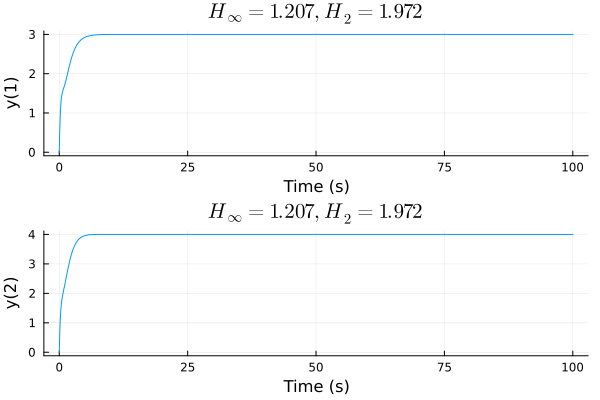

In [29]:
K = kalman(mimo2, I, I)
L = lqr(mimo2, I, I)
controller = observer_controller(mimo2, L, K)
closed = extract_y * feedback(ess, controller)

u(x, t) = [1, 2, 3, 4]
h, _ = hinfnorm(closed)
h2 = h2norm(closed)
plot(lsim(closed, u, 100), title=latexstring("H_\\infty = $(g(h)), H_2 = $(g(h2))"))

# Distributed pid controller from example in book

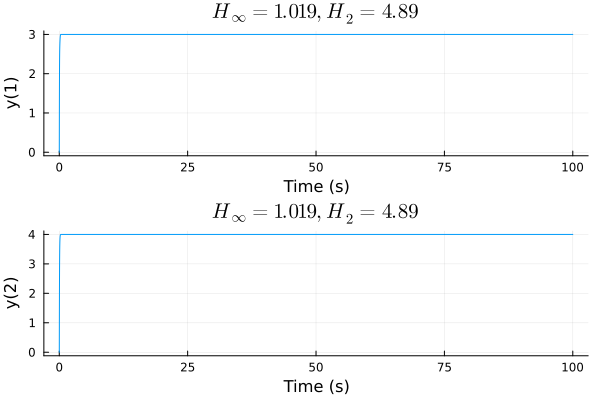

In [30]:
pid_controller = ss(
    [
        915 40.9 0 0
        0 0 922 42.2
    ]
)

closed2 = extract_y * feedback(ess, pid_controller)
h, _ = hinfnorm(closed2)
h2 = h2norm(closed2)
plot(lsim(closed2, u, 100), title=latexstring("H_\\infty = $(g(h)), H_2 = $(g(h2))"))

# Static LMI controller
$u = F C_2 x = F y$

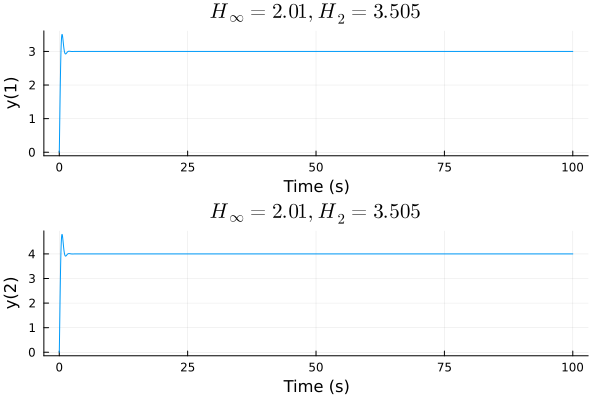

In [31]:
f, γ = lmi_static_h_inf(ess)
closed3 = extract_y * feedback(ess, ss(f))
h, _ = hinfnorm(closed3)
h2 = h2norm(closed3)
plot(lsim(closed3, u, 100), title=latexstring("H_\\infty = $(g(h)), H_2 = $(g(h2))"))

# Static LMI controller with decentralized structure
$F = \begin{bmatrix}
f_{11} & f_{12} & 0 & 0\\
0 & 0 & f_{23} & f_{24}\\
\end{bmatrix} = block\ diag(F_1, F_2)$

$u_i = F_{i} y_i$

(Not feasible)

(f, γ) = ([0.06878220210253577 21.278704000601717 0.0 0.0; 0.0 0.0 0.6648673088649173 2.8321054600448936], 2321.7722244325223)


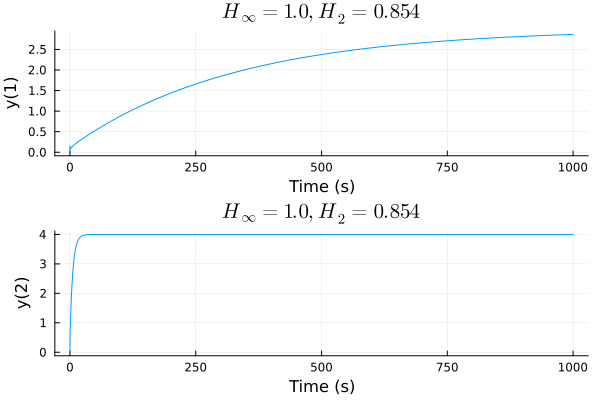

In [37]:
f, γ = lmi_static_h_inf(ess, row_block_lens = [1, 1], col_block_lens = [2, 2]; σ = 0.1)
@show f, γ
closed4 = extract_y * feedback(ess, ss(f))
h, _ = hinfnorm(closed4)
h2 = h2norm(closed4)
plot(lsim(closed4, u, 1000), title = latexstring("H_\\infty = $(g(h)), H_2 = $(g(h2))"))
# plot(title = latexstring("H_\\infty = $(g(h)), H_2 = $(g(h2))"))

In [38]:
f

2×4 Matrix{Float64}:
 0.0687822  21.2787  0.0       0.0
 0.0         0.0     0.664867  2.83211

# Bode Plot

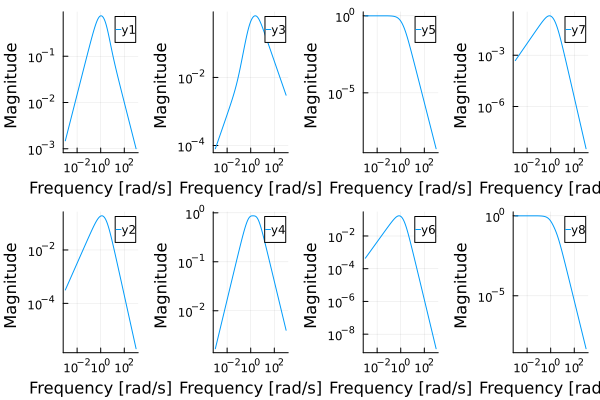

In [14]:
bodeplot(closed, plotphase=false)

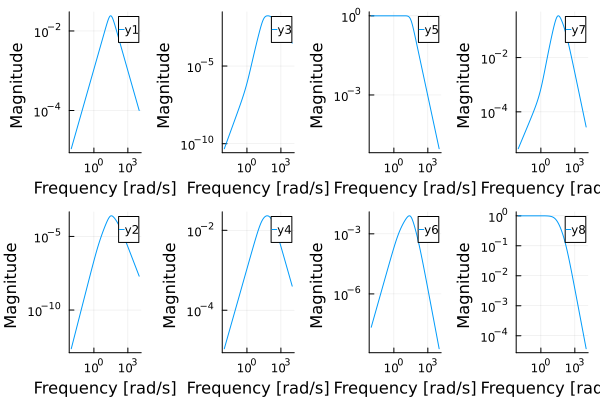

In [15]:
bodeplot(closed2, plotphase=false)

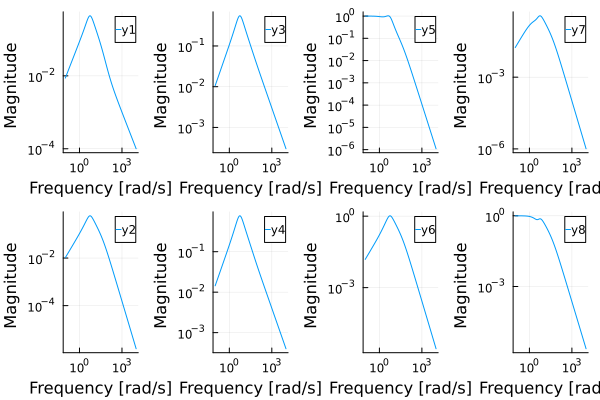

In [16]:
bodeplot(closed3, plotphase=false)

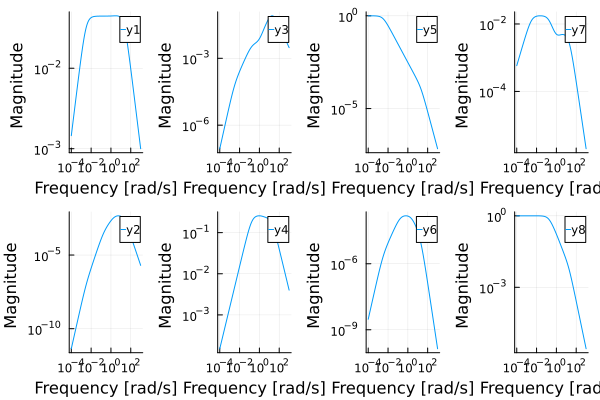

In [35]:
bodeplot(closed4, plotphase=false)